In [1]:
import os
import sys
os.chdir('..')
import tqdm

import numpy as np
import tensorflow as tf
import pandas as pd

# Get rid of the deprecation warnings
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

import matplotlib.pyplot as plt
import matplotlib as mpl

from models.models import DeepStatisticalSolver
from matplotlib.animation import FuncAnimation
import matplotlib.ticker as ticker

D:\py\anaconda3\envs\python37\lib\site-packages\tensorflow\python\framework\dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
D:\py\anaconda3\envs\python37\lib\site-packages\tensorflow\python\framework\dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
D:\py\anaconda3\envs\python37\lib\site-packages\tensorflow\python\framework\dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
D:\py\anaconda3\envs\python37\lib\site-packages\tensorflow\python\framework\dtypes.py:519: 

In [2]:
def CalculateMetrics(model, A_np, B_np, U_np, sess):
    # For the whole dataset, we will compute both the individual loss of each sample, 
    # and the final predictions
    costs_DSS = None
    costs_NR = None

    Vm_DSSs = None
    Va_DSSs = None
    Vm_NRs = None
    Va_NRs = None

   
    # In order to split the dataset, define the size of the batches that will be fed to the model.
    # For very large dataset, it can be useful to have a small value for BATCH_SIZE
    BATCH_SIZE = 100

    # Get total amount of samples and split the dataset
    n_samples_tot = A_np.shape[0]
    n_batches = n_samples_tot // BATCH_SIZE
    batched_indices = np.array_split(np.arange(n_samples_tot), n_batches) 

    # Iterate over the batches
    for indices in tqdm.tqdm(batched_indices):

        U_DSS, cost_DSS = sess.run([model.U_final, model.cost_per_sample[str(model.correction_updates)]], 
                 feed_dict = {model.A:A_np[indices], model.B:B_np[indices]}
                )

        cost_NR = sess.run(model.cost_per_sample[str(model.correction_updates)], 
                 feed_dict = {model.A:A_np[indices], model.B:B_np[indices], model.U_final:U_np[indices]}
                )

        # Getting predicted HEAD
        H_DSS = U_DSS[:, :, 0]
        H_DSS = np.reshape(H_DSS, -1)

        # Getting actual HEAD
        H_NR = U_np[indices, :, 0]
        H_NR = np.reshape(H_NR, -1)
           

        

        
        if costs_DSS is None:
            costs_DSS = cost_DSS
            costs_NR = cost_NR
            H_DSSs = H_DSS
            H_NRs = H_NR
           

        else:
            costs_DSS = np.concatenate([costs_DSS, cost_DSS])
            costs_NR = np.concatenate([costs_NR, cost_NR])
            H_DSSs = np.concatenate([H_DSSs, H_DSS])
            H_NRs = np.concatenate([H_NRs, H_NR])
           
            
    print('Loss - GNS')
    print('    10th percentile = {}'.format(np.percentile(costs_DSS, 10)))
    print('    50th percentile = {}'.format(np.percentile(costs_DSS, 50)))
    print('    90th percentile = {}'.format(np.percentile(costs_DSS, 90)))
    print('Loss - NR')
    print('(Keep in mind that the maximum precision achieved by tf.float32 is around 1e-14')
    print('Thus the loss computed by tensorflow is noisy)')
    print('    10th percentile = {}'.format(np.percentile(costs_NR, 10)))
    print('    50th percentile = {}'.format(np.percentile(costs_NR, 50)))
    print('    90th percentile = {}'.format(np.percentile(costs_NR, 90)))
    print('Correlation between methods')
    print('    Correlation H = {}'.format(np.corrcoef(H_DSSs,H_NRs)[1,0]))
  
    print('RMSE between methods')
    print('    RMSE H = {}'.format(np.sqrt(np.mean((H_DSSs-H_NRs)**2))))

    print('normalized RMSE between methods')
    print('    normalized RMSE H = {}'.format(np.sqrt(np.mean((H_DSSs-H_NRs)**2))\
          /(np.max(H_NRs)-np.min(H_NRs))))

    print('MAE between methods')
    print('    MAE H = {}'.format(np.mean(np.abs(H_DSSs-H_NRs))))

    print('normalized MAE between methods')
    print('    normalized MAE H = {}'.format(np.mean(np.abs(H_DSSs-H_NRs))\
          /(np.max(H_NRs)-np.min(H_NRs))))
 
    
    
    rmse_h_values = np.sqrt(np.mean((H_DSSs - H_NRs) ** 2))
    mean_rmse_h = np.mean(rmse_h_values)
    std_rmse_h = np.std(rmse_h_values)

    print('均值 RMSE H = {}'.format(mean_rmse_h))
    print('标准差 RMSE H = {}'.format(std_rmse_h))
   


    return H_NRs, H_DSSs

In [3]:
model_path = "results/1716448839" # supervised trained on asnet2_1, k=l=20,no scaling on H loss, initalized at 399
name='supervised'
# Enter path to data to build architecture
data_dir = 'datasets/asnet38'

# Initialize a tensorflow session
sess = tf.Session()
# Build the Deep Statistical Solver
model = DeepStatisticalSolver(sess, 
                          model_to_restore=model_path, 
                          default_data_directory=data_dir)

In [26]:
# 加载测试集数据
data_dir = 'datasets/asnet38'
mode = 'test'

A_np = np.load(os.path.join(data_dir, 'A_'+mode+'.npy'))
B_np = np.load(os.path.join(data_dir, 'B_'+mode+'.npy'))
U_np = np.load(os.path.join(data_dir, 'U_'+mode+'.npy'))

# 从 B_np 的形状中获得节点名称
n_node = np.shape(B_np[0])[0]
# 输入要移除的节点索引
nodes_to_remove_indices = [




]  # 替换为你实际要移除的节点索引

# 获取要保留的节点索引
nodes_to_keep_indices = [i for i in range(n_node) if i not in nodes_to_remove_indices]

# 过滤数据
A_np_filtered = A_np[:, :, :]  # 假设 A_np 不需要过滤
B_np_filtered = B_np[:, nodes_to_keep_indices, :]
U_np_filtered = U_np[:, nodes_to_keep_indices, :]
# 调用评估函数并传递过滤后的数据
H_NRs, H_DSSs = CalculateMetrics(model, A_np_filtered, B_np_filtered, U_np_filtered, sess)




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:23<00:00,  1.40s/it]

Loss - GNS
    10th percentile = 0.6862887263298034
    50th percentile = 0.715741753578186
    90th percentile = 0.7585343718528748
Loss - NR
(Keep in mind that the maximum precision achieved by tf.float32 is around 1e-14
Thus the loss computed by tensorflow is noisy)
    10th percentile = 0.6828186273574829
    50th percentile = 0.7155049443244934
    90th percentile = 0.7616797566413879
Correlation between methods
    Correlation H = 0.8676016924894502
RMSE between methods
    RMSE H = 0.039361613643387194
normalized RMSE between methods
    normalized RMSE H = 0.042522877068414074
MAE between methods
    MAE H = 0.015862600438736996
normalized MAE between methods
    normalized MAE H = 0.017136579169566266
均值 RMSE H = 0.039361613643387194
标准差 RMSE H = 0.0


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 17/17 [00:27<00:00,  1.62s/it]


Loss - GNS
    10th percentile = 0.6893777966499328
    50th percentile = 0.7191949486732483
    90th percentile = 0.7620212316513062
Loss - NR
(Keep in mind that the maximum precision achieved by tf.float32 is around 1e-14
Thus the loss computed by tensorflow is noisy)
    10th percentile = 0.6847780585289001
    50th percentile = 0.7175266146659851
    90th percentile = 0.763702654838562
Correlation between methods
    Correlation H = 0.7861677840863758
RMSE between methods
    RMSE H = 0.04714314717230774
normalized RMSE between methods
    normalized RMSE H = 0.05092937169670585
MAE between methods
    MAE H = 0.019716070196594552
normalized MAE between methods
    normalized MAE H = 0.021299534029211788
均值 RMSE H = 0.04714314717230774
标准差 RMSE H = 0.0
H_NRs shape: (1651195,)
H_DSSs shape: (1651195,)


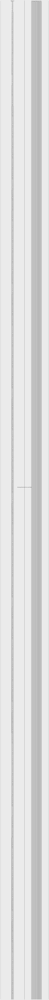

In [33]:

# 加载测试集数据
data_dir = 'datasets/asnet38'
mode = 'test'

A_np = np.load(os.path.join(data_dir, 'A_'+mode+'.npy'))
B_np = np.load(os.path.join(data_dir, 'B_'+mode+'.npy'))
U_np = np.load(os.path.join(data_dir, 'U_'+mode+'.npy'))

# 从 B_np 的形状中获得节点数量
n_node = np.shape(B_np[0])[0]

# 输入要移除的节点索引
nodes_to_remove_indices = [950
    # 替换为你实际要移除的节点索引
]

# 获取要保留的节点索引
nodes_to_keep_indices = [i for i in range(n_node) if i not in nodes_to_remove_indices]

# 过滤数据
B_np_filtered = B_np[:, nodes_to_keep_indices, :]
U_np_filtered = U_np[:, nodes_to_keep_indices, :]

# 调用评估函数时传递过滤后的数据
H_NRs, H_DSSs = CalculateMetrics(model, A_np, B_np_filtered, U_np_filtered, sess)

# 打印H_NRs和H_DSSs的形状以确认它们的维度
print(f"H_NRs shape: {H_NRs.shape}")
print(f"H_DSSs shape: {H_DSSs.shape}")

# 计算绝对差异
H_diff = np.abs(H_NRs - H_DSSs)

# 计算每个节点的平均误差
H_avg_error_per_node = np.mean(H_diff, axis=0)

# 创建每个节点的平均误差DataFrame
data_avg_error = {
    'Node #': nodes_to_keep_indices,
    'Average Absolute Error': H_avg_error_per_node
}

df_avg_error = pd.DataFrame(data_avg_error)

# 显示平均误差表格
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(10, 6))
ax.axis('off')
table_avg_error = ax.table(cellText=df_avg_error.values, colLabels=df_avg_error.columns, cellLoc='center', loc='center')
table_avg_error.auto_set_font_size(False)
table_avg_error.set_fontsize(12)
table_avg_error.scale(1.2, 1.2)

plt.title('Average Absolute Error per Node')
plt.show()

# 保存平均误差表格为CSV文件
df_avg_error.to_csv('average_absolute_error_per_node.csv', index=False)


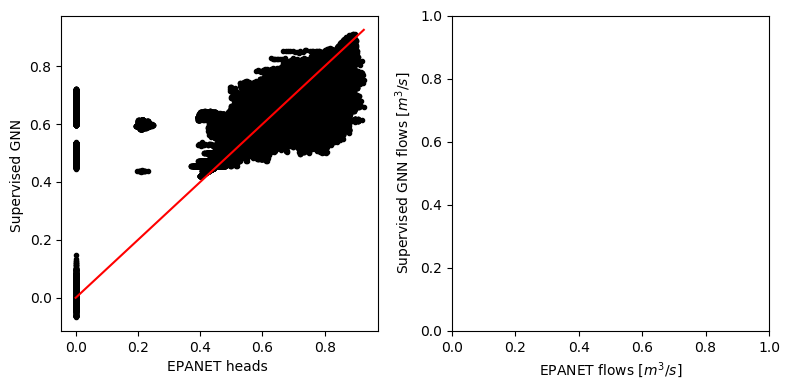

In [34]:
H_min_max = [np.min(H_NRs), np.max(H_NRs)]

fig,axs = plt.subplots(1,2, figsize = (8,4))
axs[0].plot(H_NRs, H_DSSs,'k.')
axs[0].plot(H_min_max,H_min_max, 'r-')
axs[0].set_xlabel('EPANET heads ')
axs[0].set_ylabel('Supervised GNN ');

axs[1].set_xlabel('EPANET flows [$m^3/s$]')
axs[1].set_ylabel('Supervised GNN flows [$m^3/s$]')
plt.tight_layout()
fig.savefig('correlation_'+name+'.png', dpi=500)

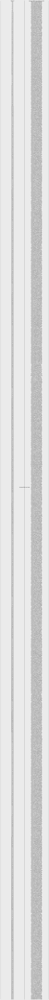

In [6]:

# Plot error bar on nodes
n_node = np.shape(B_np[0])[0]
n_edge = np.shape(A_np[0])[0]

# Reshape the arrays
H_NR_node = H_NRs.reshape((-1, n_node))
H_DSS_node = H_DSSs.reshape((-1, n_node))

# Compute the absolute difference
H_diff = np.abs(H_NR_node - H_DSS_node)

# Compute the sum of actual heads from EPANET solver
H_NR_node_sum = np.sum(H_NR_node, axis=1)

# Compute MAPE for each sample
H_MAPE_per_sample = np.abs(H_diff / H_NR_node_sum[:, np.newaxis]) * 100

# Compute the average MAPE for each node
H_MAPE_per_node = np.mean(H_MAPE_per_sample, axis=0)

# Create a DataFrame for MAPE per node
data_mape = {
    'Node #': np.arange(n_node),
    'Average MAPE Head Difference [%]': H_MAPE_per_node
}

df_mape = pd.DataFrame(data_mape)

# Display the table
fig, ax = plt.subplots(figsize=(10, 6))
ax.axis('off')
table_mape = ax.table(cellText=df_mape.values, colLabels=df_mape.columns, cellLoc='center', loc='center')
table_mape.auto_set_font_size(False)
table_mape.set_fontsize(12)
table_mape.scale(1.2, 1.2)

plt.title('Average MAPE per Node')
plt.show()

# Save the table to a CSV file
df_mape.to_csv('average_mape_per_node（41）.csv', index=False)
# Create DataFrame for each sample
sample_data = []
for i in range(len(H_diff)):
    sample_row = []
    for j in range(n_node):
        true_value = H_NR_node[i, j]
        predicted_value = H_DSS_node[i, j]
        difference = H_diff[i, j]
        sample_row.extend([true_value, predicted_value, difference])
    sample_data.append(sample_row)

# Transpose the data to get each node's values in a separate row
sample_data_transposed = np.array(sample_data).T.tolist()

# Create DataFrame for sample data
sample_df = pd.DataFrame(sample_data_transposed, columns=[f'Sample_{i+1}' for i in range(len(H_diff))])

# Display the table
fig, ax = plt.subplots(figsize=(20, 6))
ax.axis('off')
table_sample = ax.table(cellText=sample_df.values, colLabels=sample_df.columns, cellLoc='center', loc='center')
table_sample.auto_set_font_size(False)
table_sample.set_fontsize(12)
table_sample.scale(1.2, 1.2)

plt.title('Sample Data: True Values, Predicted Values, and Differences per Node')
plt.show()

# Save the table to a CSV file
sample_df.to_csv('sample_data.csv38', index=False)


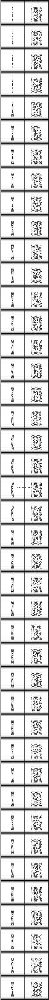

In [7]:
n_node = np.shape(B_np[0])[0]
n_edge = np.shape(A_np[0])[0]

# 重塑数组
H_NR_node = H_NRs.reshape((-1, n_node))
H_DSS_node = H_DSSs.reshape((-1, n_node))

# 计算绝对差异
H_diff = np.abs(H_NR_node - H_DSS_node)

# 计算每个节点的平均误差
H_avg_error_per_node = np.mean(H_diff, axis=0)

# 创建每个节点的平均误差DataFrame
data_avg_error = {
    'Node #': np.arange(n_node),
    'Average Absolute Error': H_avg_error_per_node
}

df_avg_error = pd.DataFrame(data_avg_error)

# 显示平均误差表格
fig, ax = plt.subplots(figsize=(10, 6))
ax.axis('off')
table_avg_error = ax.table(cellText=df_avg_error.values, colLabels=df_avg_error.columns, cellLoc='center', loc='center')
table_avg_error.auto_set_font_size(False)
table_avg_error.set_fontsize(12)
table_avg_error.scale(1.2, 1.2)

plt.title('Average Absolute Error per Node')
plt.show()

# 保存平均误差表格为CSV文件
df_avg_error.to_csv('average_absolute_error_per_node.csv', index=False)

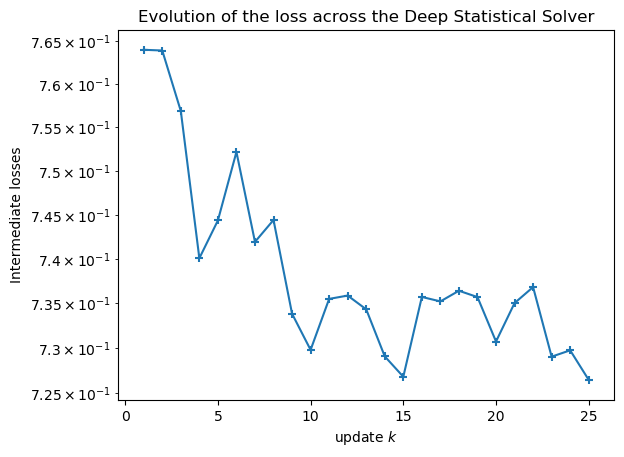

In [25]:
# Let's pick a random sample

sample = np.random.randint(0, A_np.shape[0])
# sample = 5184
H_NR = U_np[sample].reshape((n_node,))
A_sample = A_np[sample:sample+1]
B_sample = B_np[sample:sample+1]
K = A_sample[:,:,2]
Nd = B_sample[:,:,0]
demand = B_sample[:,:,1]
Nh =B_sample[:,:,2]
elevation = B_sample[:,:,3]
from_node = np.array(A_sample[:,:,0],dtype=int)
to_node = np.array(A_sample[:,:,1],dtype=int)




# Predict and gather latent variables, intermediate predictions and the loss
feed_dict = {model.A:A_sample, model.B:B_sample}
H_list, U_list, loss_list = sess.run([model.H, model.U, model.loss], feed_dict = feed_dict)

# Convert those dictionaries into actual np array
head = np.array([u[0,:,:] for u in U_list.values()])
latent = np.array([h[0,:,:] for h in H_list.values()])
loss = np.array([l for l in loss_list.values()])

# Plotting the loss
plt.plot(np.arange(1,loss.shape[0]+1),loss)
plt.scatter(np.arange(1,loss.shape[0]+1), loss, marker='+')
plt.yscale('log')
plt.ylabel('Intermediate losses')
plt.xlabel(r'update $k$')
plt.title('Evolution of the loss across the Deep Statistical Solver')
plt.show()